<a href="https://colab.research.google.com/github/rajashekar/colab/blob/main/MLE_Perception_Engineer_Uber_v1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Today you are a MLE at Uber Perception Stack Team!**
## Your team is developing new software around automated detection of cars, pedestrians at all conditions for autonomous drive. One major bottleneck is data collection under severe weather conditions, especially capturing night-time images. So your task is to generate night time equivalent images from daytime images, such that you have access to some outdoor images acquired at night and some at day, but no pairwise images are available.

### *Pairwise image means*: same view available in Day and Night times.


In this assignment we implement CycleGAN using Keras with the intention to transform Day time to night time images for Autonomous Drive like in:
https://github.com/simontomaskarlsson/CycleGAN-Keras

This work is an adaptation of the blog in: https://machinelearningmastery.com/how-to-develop-cyclegan-models-from-scratch-with-keras/

#Lets start with the concepts of CycleGAN:

The model architecture is comprised of two generator models: one generator (Generator-A) for generating images for the first domain (Domain-A) and the second generator (Generator-B) for generating images for the second domain (Domain-B). Lets consider here, **Domain-A: Daytime**, **Domain-B: Nighttime**

* Generator-A -> Domain-A
* Generator-B -> Domain-B

The generator models perform image translation, meaning that the image generation process is conditional on an input image, specifically an image from the other domain. Generator-A takes an image from Domain-B as input and Generator-B takes an image from Domain-A as input.

* Domain-B -> Generator-A -> Domain-A
* Domain-A -> Generator-B -> Domain-B
Each generator has a corresponding discriminator model.

The first discriminator model (Discriminator-A) takes real images from Domain-A (daytime images) and generated images from Generator-A and predicts whether they are real or fake. The second discriminator model (Discriminator-B) takes real images from Domain-B (night-time images) and generated images from Generator-B and predicts whether they are real or fake.

* Domain-A -> Discriminator-A -> [Real/Fake]
* Domain-B -> Generator-A -> Discriminator-A -> [Real/Fake]
* Domain-B -> Discriminator-B -> [Real/Fake]
* Domain-A -> Generator-B -> Discriminator-B -> [Real/Fake]
The discriminator and generator models are trained in an adversarial zero-sum process, like normal GAN models.

The generators learn to better fool the discriminators and the discriminators learn to better detect fake images. Together, the models find an equilibrium during the training process.

Passing an image through both generators is called a cycle. Together, each pair of generator models are trained to better reproduce the original source image, referred to as cycle consistency.

* Domain-B -> Generator-A -> Domain-A -> Generator-B -> Domain-B
* Domain-A -> Generator-B -> Domain-B -> Generator-A -> Domain-A


**Our goal is to train such a 2 set Generator-Discriminator pair, to finally generate night-time images from day-time ones and quantify performance...**



# Task 0: Install libraries and load data

In [1]:
!pip install -U tensorflow-addons

     |████████████████████████████████| 679 kB 8.0 MB/s 


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
%cd /content/drive/MyDrive/Colab/Fourth.Brain/CycleGAN/

/content/drive/MyDrive/Colab/Fourth.Brain/CycleGAN


In [ ]:
!unzip training.zip

In [5]:
%cd training/

/content/drive/MyDrive/Colab/Fourth.Brain/CycleGAN/training


In [7]:
import os
# The path below should point to the directory containing this notebook and the associated utility files
# Change it if necessary
os.chdir('/content/drive/MyDrive/Colab/Fourth.Brain/CycleGAN/training/')
!ls

day  discriminator_model_plot.png  generator_model_plot.png  night


## **Task 1 [Instructor Led]:  Design functions for Generator-Discriminator pairs**: 


Step 1: Lets start by stepwise defining all libraries and functions needed to generate the model and pre-process the data

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 128, 128, 128)     131200    
_________________________________________________________________
instance_normalization (Inst (None, 128, 128, 128)     256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 128, 128, 128)     0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 128, 128, 256)     524544

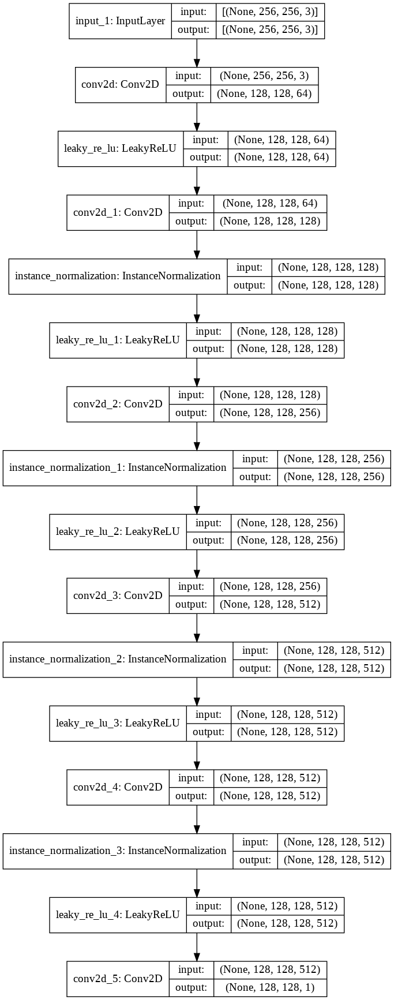

In [8]:
#Step 1: Defining a Patchgan discriminator model
import tensorflow_addons as tfa
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras import Model
from tensorflow.keras import Input
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import BatchNormalization
from tensorflow_addons.layers import InstanceNormalization
from tensorflow.keras.utils import plot_model
import tensorflow as tf

# define the discriminator model
def define_discriminator(image_shape):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# source image input
	in_image = Input(shape=image_shape)
	# C64
	d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(in_image)
	d = LeakyReLU(alpha=0.2)(d) #Stride reduces shape of image
	# C128
	d = Conv2D(128, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization()(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C256
	d = Conv2D(256, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization()(d)
	d = LeakyReLU(alpha=0.2)(d)
	# C512
	d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization()(d)
	d = LeakyReLU(alpha=0.2)(d)
	# second last output layer
	d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
	d = InstanceNormalization()(d)
	d = LeakyReLU(alpha=0.2)(d)
	# patch output
	patch_out = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
	# define model
	model = Model(in_image, patch_out)
	# compile model
	model.compile(loss='mse', optimizer=Adam(lr=0.0002, beta_1=0.5), loss_weights=[0.5])
	return model

# define image shape
image_shape = (256,256,3)
# create the model
model = define_discriminator(image_shape)
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='discriminator_model_plot.png', show_shapes=True, show_layer_names=True)

#############Note the final shape of the image patch=Patch size########################

In [9]:
#Step 2: Generator Model
# generator a resnet block
def resnet_block(n_filters, input_layer):
	# weight initialization
	init = RandomNormal(stddev=0.02)
	# first layer convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(input_layer)
	g = InstanceNormalization()(g)
	g = Activation('relu')(g)
	# second convolutional layer
	g = Conv2D(n_filters, (3,3), padding='same', kernel_initializer=init)(g)
	g = InstanceNormalization()(g)
	# concatenate merge channel-wise with input layer
	g = Concatenate()([g, input_layer])
	return g

In [10]:
# define the standalone generator model
def define_generator(image_shape=(256,256,3), n_resnet=9):
	# weight initialization
  init = RandomNormal(stddev=0.02)
  # image input
  in_image = Input(shape=image_shape)
  # c7s1-64
  g = Conv2D(64, (7,7), padding='same', kernel_initializer=init)(in_image)
  g=InstanceNormalization()(g)
  g = Activation('relu')(g)
  # d128
  g = Conv2D(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
  g=InstanceNormalization()(g)
  g = Activation('relu')(g)
  # d256
  g = Conv2D(256, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
  g=InstanceNormalization()(g)
  g = Activation('relu')(g)
  # R256
  for _ in range(n_resnet):
    g = resnet_block(256, g)
  # u128
  g = Conv2DTranspose(128, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
  g=InstanceNormalization()(g)
  g = Activation('relu')(g)
  # u64
  g = Conv2DTranspose(64, (3,3), strides=(2,2), padding='same', kernel_initializer=init)(g)
  g=InstanceNormalization()(g)
  g = Activation('relu')(g)
  # c7s1-3
  g = Conv2D(3, (7,7), padding='same', kernel_initializer=init)(g)
  g=InstanceNormalization()(g)
  out_image = Activation('sigmoid')(g)
  # define model
  model = Model(in_image, out_image)
  return model

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 256, 256, 64) 9472        input_2[0][0]                    
__________________________________________________________________________________________________
instance_normalization_4 (Insta (None, 256, 256, 64) 128         conv2d_6[0][0]                   
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 64) 0           instance_normalization_4[0][0]   
____________________________________________________________________________________________

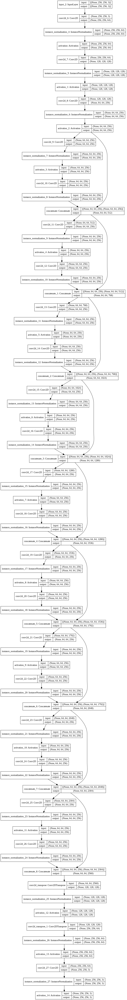

In [11]:
# create the model
model = define_generator()
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='generator_model_plot.png', show_shapes=True, show_layer_names=True)

In [12]:
# Step 3: Define a composite model for updating generators by adversarial and cycle loss
def define_composite_model(g_model_1, d_model, g_model_2, image_shape):
	# ensure the model we're updating is trainable
	g_model_1.trainable = True
	# mark discriminator as not trainable
	d_model.trainable = False
	# mark other generator model as not trainable
	g_model_2.trainable = False
	# discriminator element
	input_gen = Input(shape=image_shape)
	gen1_out = g_model_1(input_gen)
	output_d = d_model(gen1_out)
	# identity element
	input_id = Input(shape=image_shape)
	output_id = g_model_1(input_id)
	# forward cycle
	output_f = g_model_2(gen1_out)
	# backward cycle
	gen2_out = g_model_2(input_id)
	output_b = g_model_1(gen2_out)
	# define model graph
	model = Model([input_gen, input_id], [output_d, output_id, output_f, output_b])
	# define optimization algorithm configuration
	opt = Adam(lr=0.0002, beta_1=0.5)
	# compile model with weighting of least squares loss and L1 loss
	model.compile(loss=['mse', 'mae', 'mae', 'mae'], loss_weights=[1, 5, 10, 10], optimizer=opt)
	return model
  ############Notice no cross enytropy loss used here######################################

In [13]:
#Step 4: All definitions together
# input shape
image_shape = (256,256,3)
# generator: A -> B
g_model_AtoB = define_generator(image_shape)
# generator: B -> A
g_model_BtoA = define_generator(image_shape)
# discriminator: A -> [real/fake]
d_model_A = define_discriminator(image_shape)
# discriminator: B -> [real/fake]
d_model_B = define_discriminator(image_shape)
# composite: A -> B -> [real/fake, A]
c_model_AtoB = define_composite_model(g_model_AtoB, d_model_B, g_model_BtoA, image_shape)
# composite: B -> A -> [real/fake, B]
c_model_BtoA = define_composite_model(g_model_BtoA, d_model_A, g_model_AtoB, image_shape)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [14]:
#Step 5: Helper functions to select real samples and generate fake samples

from random import randint
#write a function to generate 'n_samples' random integers in range (start,stop)
def randnums(start,stop,n_samples):
  ix=[]
  for i in range(n_samples):
    ix.append(randint(start,stop))
  ix=np.array(ix)
  return ix

In [15]:
# select a batch of random samples, returns images and target
def generate_real_samples(dataset, n_samples, patch_shape):
# choose random instances
  ix = randnums(0, dataset.shape[0]-1, n_samples)
  # retrieve selected images
  #print(ix,np.shape(dataset))
  X = dataset[ix]
  # generate 'real' class labels (1)
  y = np.ones((n_samples, patch_shape, patch_shape, 1))
  return X, y


In [16]:
# generate a batch of images, returns images and targets
def generate_fake_samples(g_model, dataset, patch_shape):
	# generate fake instance
	X = g_model.predict(dataset)
	# create 'fake' class labels (0)
	y = np.zeros((len(X), patch_shape, patch_shape, 1))
	return X, y

In [17]:
# update image pool for fake images
import random
def update_image_pool(pool, images, max_size=50):
  selected = list()
  for image in images:
    if len(pool) < max_size:
    # stock the pool
      pool.append(image)
      selected.append(image)
    elif random.random() < 0.5:
      # use image, but don't add it to the pool
      selected.append(image)
    else:
      # replace an existing image and use replaced image
      ix = randint(0, len(pool)-1)
      print(ix,np.shape(pool))
      selected.append(pool[ix])
      pool[ix] = image
  return np.asarray(selected)


# All helper functions are now defined, now lets begin training!

Order of tasks:
* Update Generator-B (A->B)
* Update Discriminator-B
* Update Generator-A (B->A)
* Update Discriminator-A

In [18]:
# train function for the cyclegan models
def train(d_model_A, d_model_B, g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, trainA,trainB):

  # define properties of the training run
  n_epochs, n_batch, = 10, 1 #Keep n_batch as 1 for per image training. n_epochs can be changed
  # determine the output square shape of the discriminator
  n_patch = d_model_A.output_shape[1] #Notice n_patch depends on the discriminator output image size. This parameter can be changed for improvement.
  
  # prepare image pool for fakes
  poolA, poolB = list(), list()
  # calculate the number of batches per training epoch
  bat_per_epo = int(len(trainA) / n_batch)
  # calculate the number of training iterations
  n_steps = bat_per_epo * n_epochs
  # manually enumerate epochs
  print(n_steps)
  for i in range(n_steps):
  # select a batch of real samples
    X_realA, y_realA = generate_real_samples(trainA, n_batch, n_patch)
    X_realB, y_realB = generate_real_samples(trainB, n_batch, n_patch)
    
    # generate a batch of fake samples
    X_fakeA, y_fakeA = generate_fake_samples(g_model_BtoA, X_realB, n_patch)
    X_fakeB, y_fakeB = generate_fake_samples(g_model_AtoB, X_realA, n_patch)
    # update fakes from pool
    X_fakeA = update_image_pool(poolA, X_fakeA)
    X_fakeB = update_image_pool(poolB, X_fakeB)
    # update generator B->A via adversarial and cycle loss
    g_loss2, _, _, _, _ = c_model_BtoA.train_on_batch([X_realB, X_realA], [y_realA, X_realA, X_realB, X_realA])
    # update discriminator for A -> [real/fake]
    dA_loss1 = d_model_A.train_on_batch(X_realA, y_realA)
    dA_loss2 = d_model_A.train_on_batch(X_fakeA, y_fakeA)
    # update generator A->B via adversarial and cycle loss
    g_loss1, _, _, _, _ = c_model_AtoB.train_on_batch([X_realA, X_realB], [y_realB, X_realB, X_realA, X_realB])
    # update discriminator for B -> [real/fake]
    dB_loss1 = d_model_B.train_on_batch(X_realB, y_realB)
    dB_loss2 = d_model_B.train_on_batch(X_fakeB, y_fakeB)
    # summarize performance
    print('>%d, dA[%.3f,%.3f] dB[%.3f,%.3f] g[%.3f,%.3f]' % (i+1, dA_loss1,dA_loss2, dB_loss1,dB_loss2, g_loss1,g_loss2))
  return(g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA)

# **Task 2: Train the model from scratch** 
# Load the images DomainA-> Day, DomainB-> Night. 
You may use as many as 50 images to train the generator. More images will need more epochs and more train time. So limit training images to 30-50 images from each domain.
# Call the train function to train on the images


In [19]:
import numpy as np
import pathlib

import matplotlib as mpl

import IPython.display as display
import PIL.Image

from tensorflow.keras.preprocessing import image
import cv2

In [22]:
!ls

day  discriminator_model_plot.png  generator_model_plot.png  night


In [37]:
# load a daytime images as trainA, nighttime images as train B (numpy lists)
############START CODE HERE##################################3
data_dir = pathlib.Path.cwd()
# image_count = len(list(data_dir.glob('*/*.jpg')))
day_images = list(data_dir.glob('day/*'))
trainA = np.array([cv2.resize(np.true_divide(cv2.imread(str(image)), 255.0), (256,256)) for image in day_images[:50]])
night_images = list(data_dir.glob('night/*'))
trainB = np.array([cv2.resize(np.true_divide(cv2.imread(str(image)), 255.0), (256,256)) for image in night_images[:50]])
#################################################################

# Next train the cycleGAN using the train function!

In [38]:
# train CycleGAN
############START CODE HERE##############################
#Call the function 
g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA = train(d_model_A, d_model_B,
                                                               g_model_AtoB, g_model_BtoA, 
                                                               c_model_AtoB, c_model_BtoA,
                                                               trainA,trainB)
#####################################################################

500
>1, dA[0.362,0.330] dB[0.447,0.231] g[9.999,9.717]
>2, dA[0.112,0.188] dB[0.210,0.272] g[5.879,5.947]
>3, dA[0.224,0.206] dB[0.175,0.165] g[6.196,6.432]
>4, dA[0.134,0.163] dB[0.236,0.180] g[5.691,5.976]
>5, dA[0.106,0.099] dB[0.175,0.172] g[5.355,5.964]
>6, dA[0.082,0.150] dB[0.172,0.116] g[5.044,4.866]
>7, dA[0.207,0.181] dB[0.126,0.136] g[4.606,5.083]
>8, dA[0.115,0.232] dB[0.111,0.106] g[4.302,3.991]
>9, dA[0.107,0.127] dB[0.053,0.177] g[7.796,7.045]
>10, dA[0.263,0.270] dB[0.476,0.187] g[4.962,4.998]
>11, dA[0.267,0.156] dB[0.212,0.182] g[4.965,4.838]
>12, dA[0.248,0.215] dB[0.173,0.172] g[4.661,4.504]
>13, dA[0.192,0.176] dB[0.153,0.114] g[4.717,4.311]
>14, dA[0.599,0.326] dB[0.124,0.195] g[4.898,4.983]
>15, dA[0.249,0.263] dB[0.118,0.091] g[8.163,7.307]
>16, dA[0.219,0.198] dB[0.284,0.162] g[6.442,5.687]
>17, dA[0.201,0.234] dB[0.136,0.122] g[8.203,7.045]
>18, dA[0.195,0.155] dB[0.263,0.098] g[6.306,5.504]
>19, dA[0.216,0.191] dB[0.141,0.171] g[6.883,5.630]
>20, dA[0.171,0.1

# **Task 3**: Write a test function to generate fake images for the test set
### Create Day->Night, Night->Day. versions separately
### Visualize some images. What parameters would you change to improve?
Hint: Use the format of the train function to create the test function.

In [39]:
#Define a test function to generate day to night images
import matplotlib.pyplot as plt
def test(g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, trainA,trainB):
###################START CODE HERE#############################
    X_realA, _ = generate_real_samples(trainA, 1, 16)
    X_fakeB, _ = generate_fake_samples(g_model_AtoB, X_realA, 16)
  
    X_realB, _ = generate_real_samples(trainB, 1, 16)
    X_fakeA, _ = generate_fake_samples(g_model_BtoA, X_realB, 16)
###############################################################    
    ########First Day to night transformation
    print('Original Day Image is=\n')
    plt.imshow(np.squeeze(X_realA))
    plt.show()
    print('Fake Night image is=\n')
    plt.imshow(np.squeeze(X_fakeB))
    plt.show()
    #############Next Night to Day transformation
    print('Original Night Image is=\n')
    plt.imshow(np.squeeze(X_realB))
    plt.show()
    print('Fake Day image is=\n')
    plt.imshow(np.squeeze(X_fakeA))
    plt.show()


Original Day Image is=



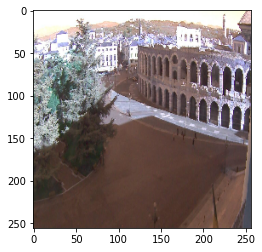

Fake Night image is=



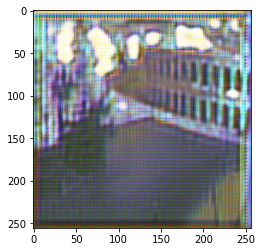

Original Night Image is=



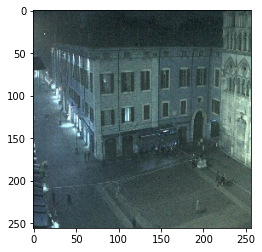

Fake Day image is=



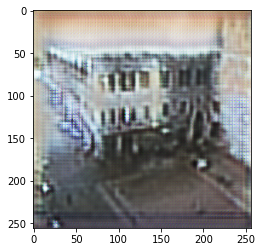

In [40]:
##Call the test function here test(.....)
#########START CODE HERE###############################
test(g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, trainA, trainB)
########################################################

 # Notice a Banding around edges for the nighttime images. What paremeter would you change to reduce this banding?

# **Task 4**: Write a function to generate a full cycle Day->night->Day
[Hint]: Use the template in the train function to start with Day image and plot the cyclic day image generated.

# Write a function to quantify the error and similarity between the cycle generated image and original image (Day vs Generated Day)
[Hint]: Find mse and structural similarity between real and fake images to gauge the quality of cycleGAN.



In [41]:
from skimage.metrics import mean_squared_error, structural_similarity
#Function to compute similarity in Cycle images
def similarity_real_fake(real,fake):
  ###################Start Code Here#######################################
  mse = mean_squared_error(real, fake)
  sim = structural_similarity(real, fake, multichannel=True, gaussian_weights=True, sigma=1.5)

  print(f'MSE - {mse}, SIM - {sim}') 
  ################################################################

In [42]:
def test_Cycle(g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, trainA,trainB):

  # write this function to call the similarity_real_fake function above and print it under each real->Generated image pair
  ##############START CODE HERE#####################################################
  n_steps = 50

  for i in range(n_steps):
    X_realA, y_realA = generate_real_samples(trainA, 1, 32)
    X_realB, y_realB = generate_real_samples(trainB, 1, 32)

    X_fakeA, y_fakeA = generate_fake_samples(g_model_BtoA, X_realB, 32)
    X_fakeB, y_fakeB = generate_fake_samples(g_model_AtoB, X_realA, 32)

    X_fakeA1, y_fakeA1 = generate_fake_samples(g_model_BtoA, X_fakeB, 32)
    X_fakeB1, y_fakeB1 = generate_fake_samples(g_model_AtoB, X_fakeA, 32)

    print("Original Day Image")
    plt.imshow(np.squeeze(X_realA))
    plt.show()

    print("Generated Day Image")
    plt.imshow(np.squeeze(X_fakeA1))
    plt.show()
    similarity_real_fake(np.squeeze(X_realA), np.squeeze(X_fakeA1))

    print("Original Night Image")
    plt.imshow(np.squeeze(X_realB))
    plt.show()

    print("Generated Night Image")
    plt.imshow(np.squeeze(X_fakeB1))
    plt.show()
    similarity_real_fake(np.squeeze(X_realB), np.squeeze(X_fakeB1))
  ###############################################################################

Original Day Image


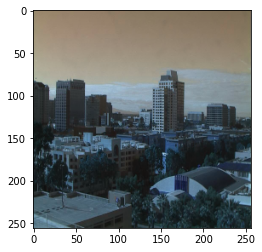

Generated Day Image


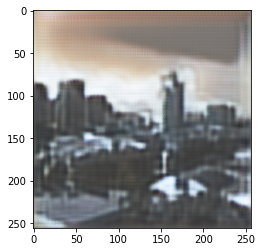

MSE - 0.03035604087963775, SIM - 0.69672956699831
Original Night Image


/usr/local/lib/python3.7/dist-packages/skimage/metrics/_structural_similarity.py:108: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  im2[..., ch], **args)


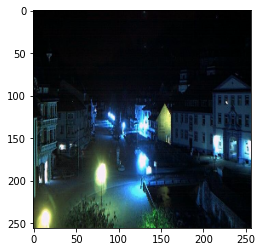

Generated Night Image


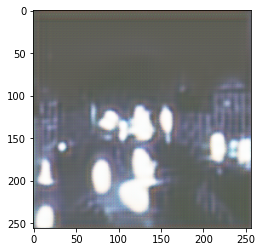

MSE - 0.11377454439849562, SIM - 0.27686508003432875
Original Day Image


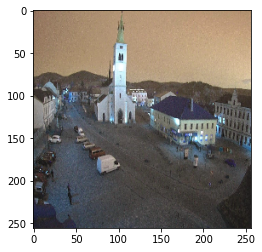

Generated Day Image


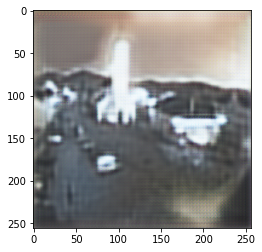

MSE - 0.022009284936142928, SIM - 0.6962281690967081
Original Night Image


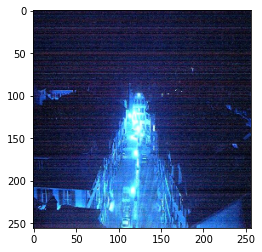

Generated Night Image


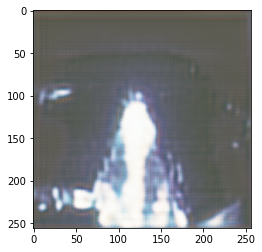

MSE - 0.06929983961657642, SIM - 0.4158729397934213
Original Day Image


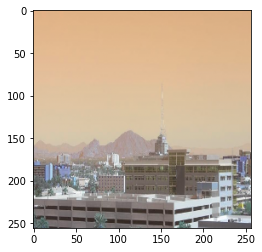

Generated Day Image


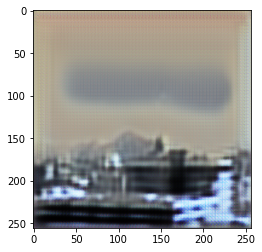

MSE - 0.02989113344363473, SIM - 0.7428525208768834
Original Night Image


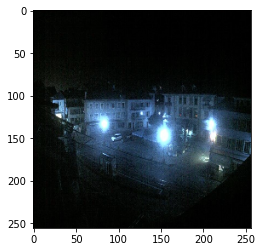

Generated Night Image


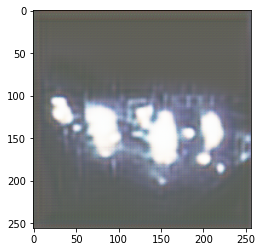

MSE - 0.1290986035318972, SIM - 0.2105813544853207
Original Day Image


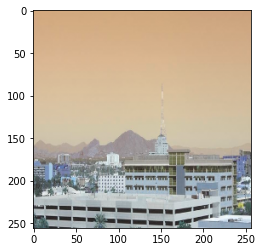

Generated Day Image


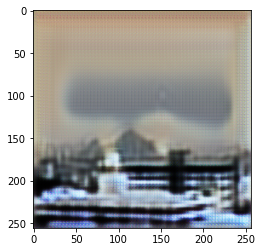

MSE - 0.03885387680187475, SIM - 0.6899467940198368
Original Night Image


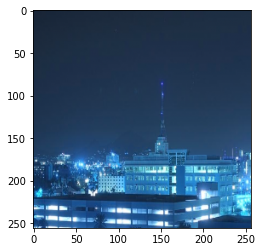

Generated Night Image


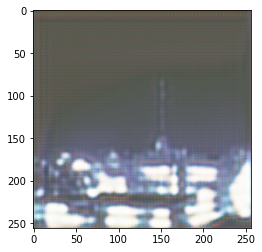

MSE - 0.04870957373082682, SIM - 0.6661794102643138
Original Day Image


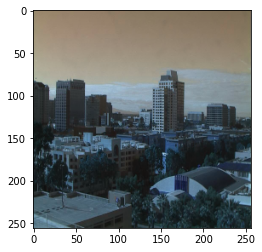

Generated Day Image


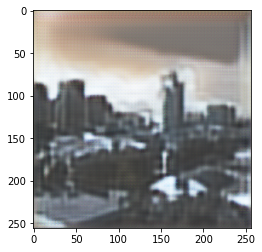

MSE - 0.03035604057657348, SIM - 0.6967295694515171
Original Night Image


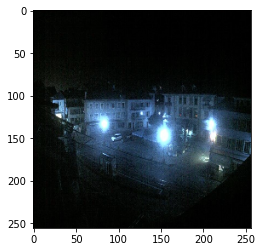

Generated Night Image


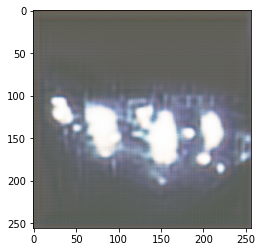

MSE - 0.1290986032923209, SIM - 0.21058135524738186
Original Day Image


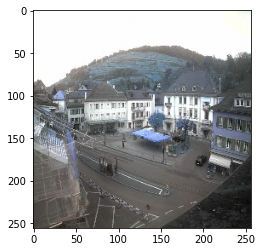

Generated Day Image


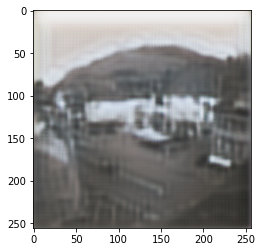

MSE - 0.013258272513345286, SIM - 0.6752530834420093
Original Night Image


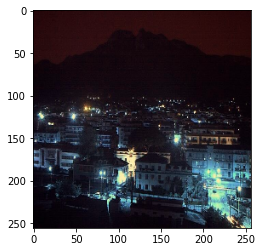

Generated Night Image


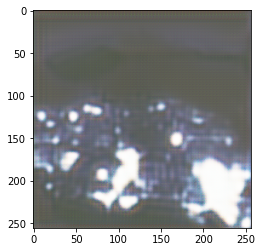

MSE - 0.11403774163668545, SIM - 0.29860067174112626
Original Day Image


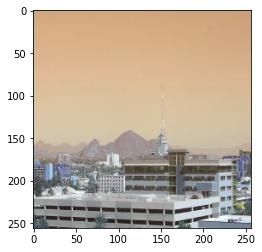

Generated Day Image


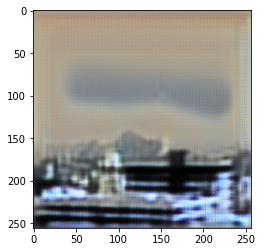

MSE - 0.0289395980029218, SIM - 0.7291063620369697
Original Night Image


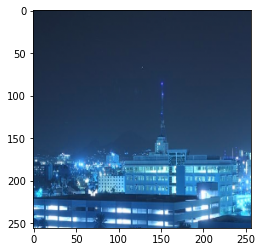

Generated Night Image


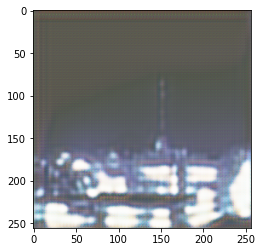

MSE - 0.045444757251401284, SIM - 0.6746710390822891
Original Day Image


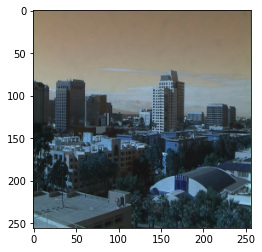

Generated Day Image


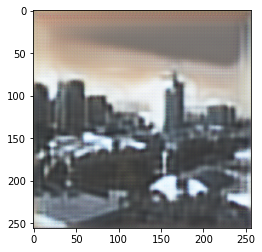

MSE - 0.03160679834331618, SIM - 0.6852939336032572
Original Night Image


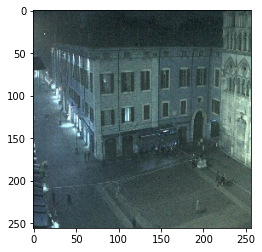

Generated Night Image


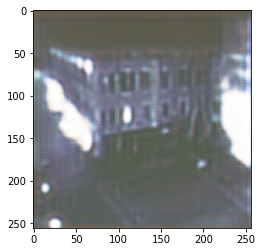

MSE - 0.030562897519070844, SIM - 0.6252679550706409
Original Day Image


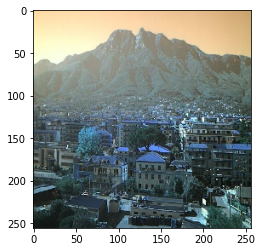

Generated Day Image


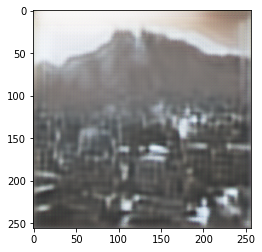

MSE - 0.016769976173193066, SIM - 0.5989267016351117
Original Night Image


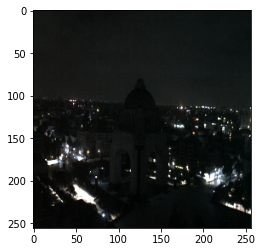

Generated Night Image


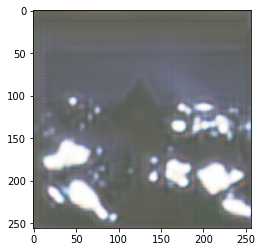

MSE - 0.15616546781039095, SIM - 0.2641933440720594
Original Day Image


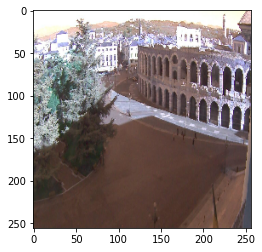

Generated Day Image


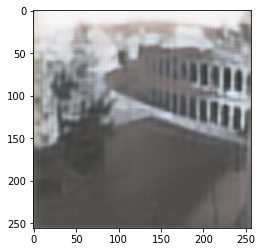

MSE - 0.013966219561921546, SIM - 0.65992487376968
Original Night Image


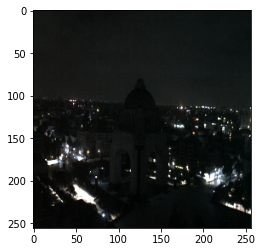

Generated Night Image


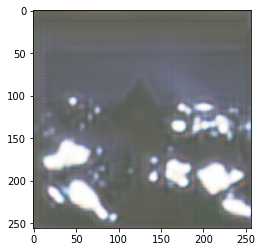

MSE - 0.1561654690261726, SIM - 0.26419334253106663
Original Day Image


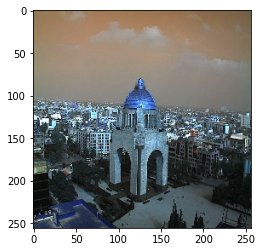

Generated Day Image


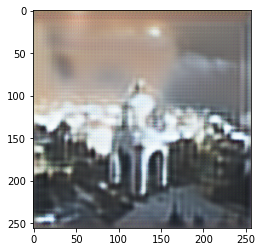

MSE - 0.037401111668932015, SIM - 0.6014337392222994
Original Night Image


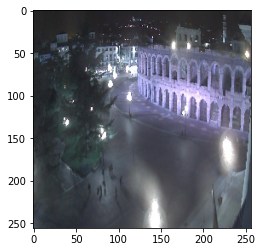

Generated Night Image


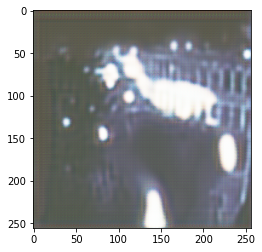

MSE - 0.022256646376924923, SIM - 0.6972659551839137
Original Day Image


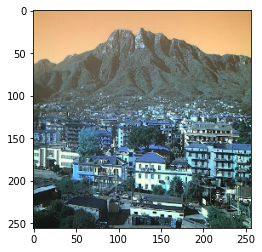

Generated Day Image


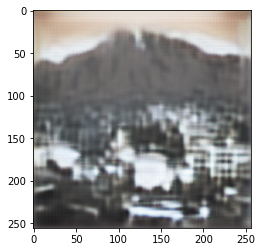

MSE - 0.02870859125144636, SIM - 0.523279484690058
Original Night Image


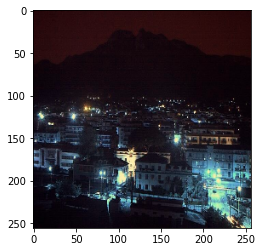

Generated Night Image


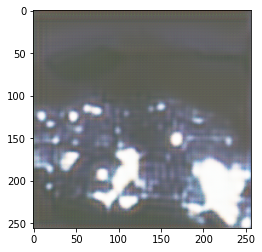

MSE - 0.11403774247149386, SIM - 0.29860067075695246
Original Day Image


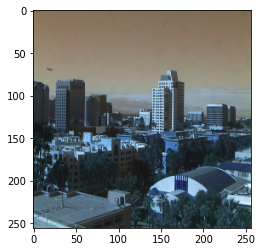

Generated Day Image


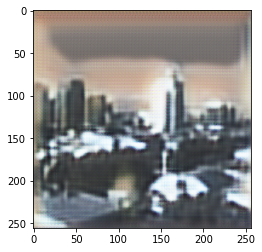

MSE - 0.03488810048048508, SIM - 0.6356842016382028
Original Night Image


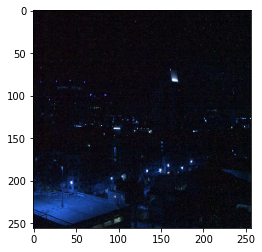

Generated Night Image


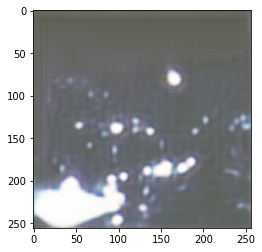

MSE - 0.1669482893622183, SIM - 0.2066606092443906
Original Day Image


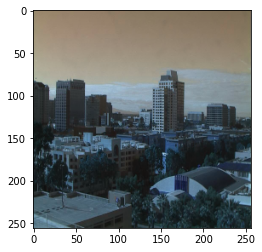

Generated Day Image


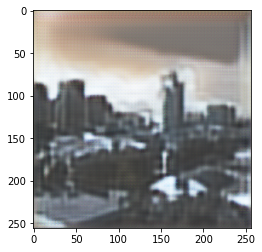

MSE - 0.030356040571212273, SIM - 0.6967295678340341
Original Night Image


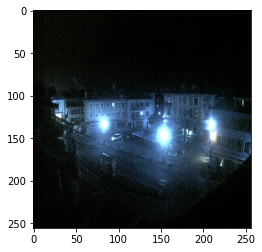

Generated Night Image


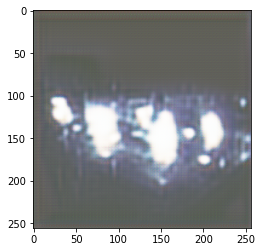

MSE - 0.12384979020701654, SIM - 0.22924282513663627
Original Day Image


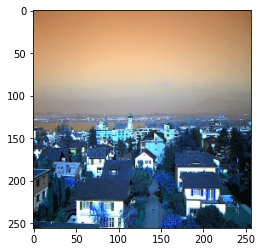

Generated Day Image


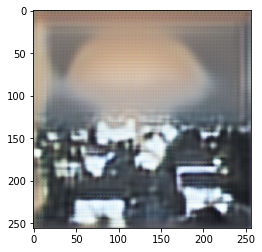

MSE - 0.03046594380867633, SIM - 0.6364367013415907
Original Night Image


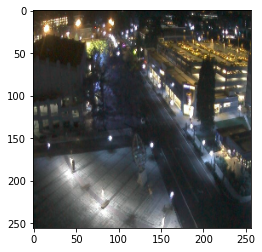

Generated Night Image


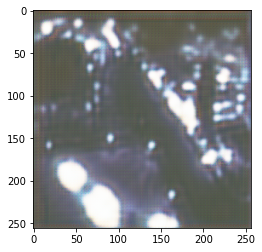

MSE - 0.04688211057584912, SIM - 0.5791142314771509
Original Day Image


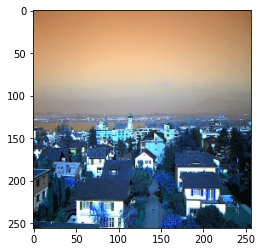

Generated Day Image


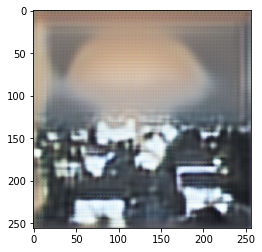

MSE - 0.030465944447130865, SIM - 0.636436701522232
Original Night Image


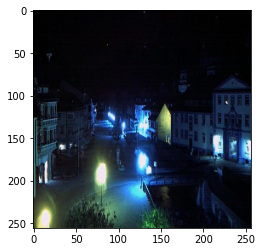

Generated Night Image


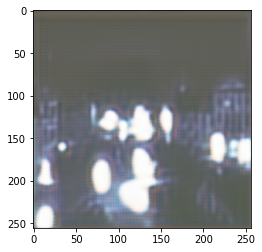

MSE - 0.11870490134977531, SIM - 0.2607264917510898
Original Day Image


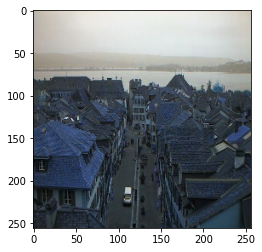

Generated Day Image


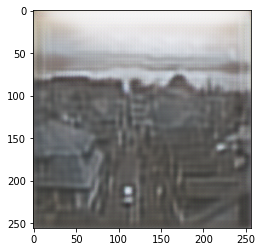

MSE - 0.01702546426015807, SIM - 0.6814620928942775
Original Night Image


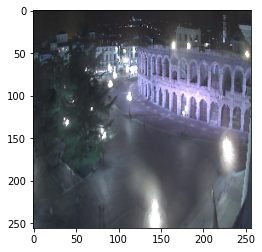

Generated Night Image


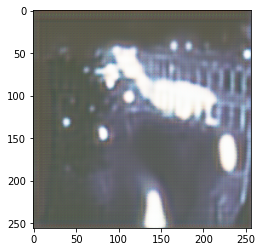

MSE - 0.021920659822297916, SIM - 0.7023056068314987
Original Day Image


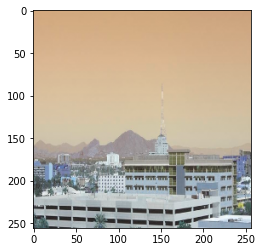

Generated Day Image


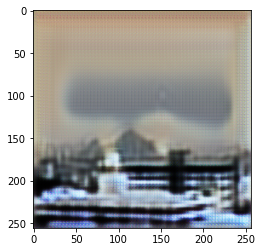

MSE - 0.03885387870086315, SIM - 0.6899467772595367
Original Night Image


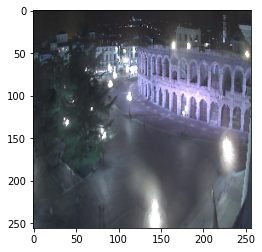

Generated Night Image


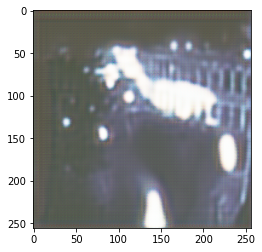

MSE - 0.02192066001422398, SIM - 0.7023056075841773
Original Day Image


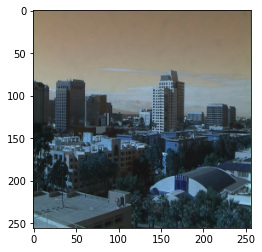

Generated Day Image


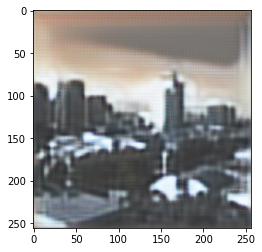

MSE - 0.03160679821986534, SIM - 0.685293931124356
Original Night Image


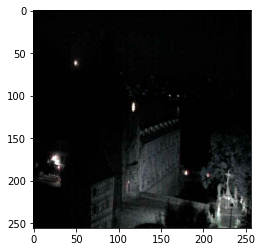

Generated Night Image


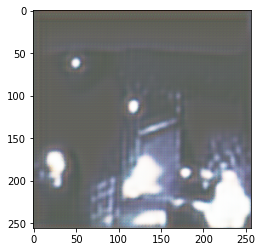

MSE - 0.17448533609173789, SIM - 0.10519803983226245
Original Day Image


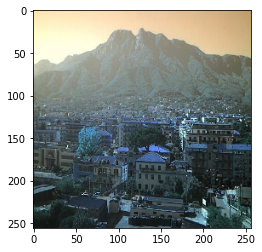

Generated Day Image


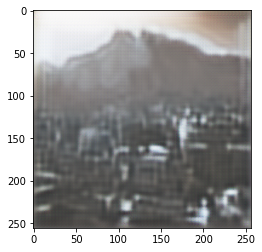

MSE - 0.016194624157120724, SIM - 0.6294886587332941
Original Night Image


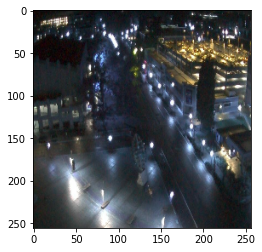

Generated Night Image


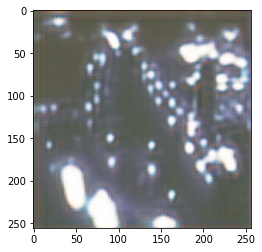

MSE - 0.058893115458419056, SIM - 0.5388453935961827
Original Day Image


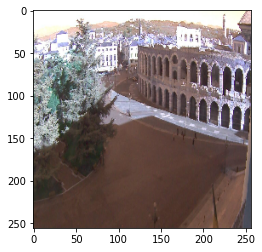

Generated Day Image


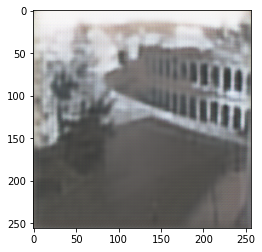

MSE - 0.013966219645448882, SIM - 0.6599248738351644
Original Night Image


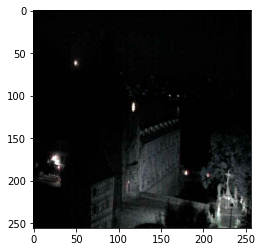

Generated Night Image


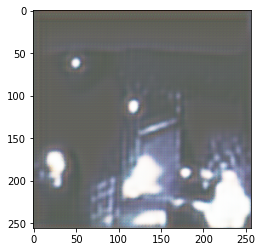

MSE - 0.17448533311278483, SIM - 0.10519804060638101
Original Day Image


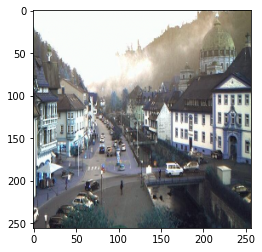

Generated Day Image


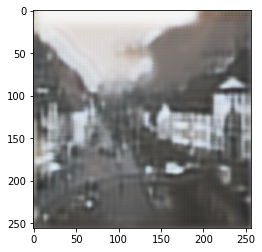

MSE - 0.016481019706864813, SIM - 0.6727652979743866
Original Night Image


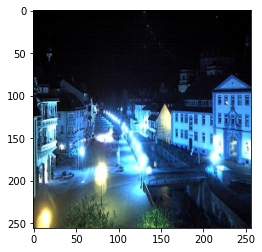

Generated Night Image


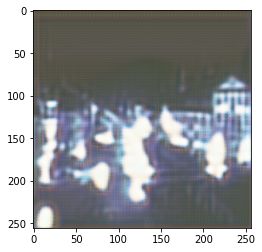

MSE - 0.06472146041843085, SIM - 0.3802781360491043
Original Day Image


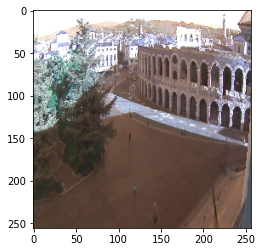

Generated Day Image


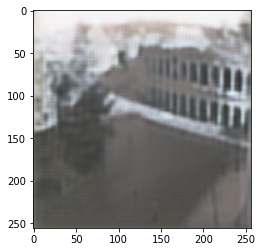

MSE - 0.013131931255931215, SIM - 0.6770071476415734
Original Night Image


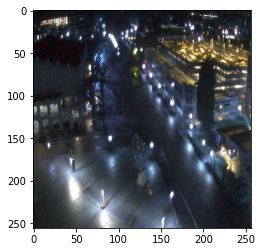

Generated Night Image


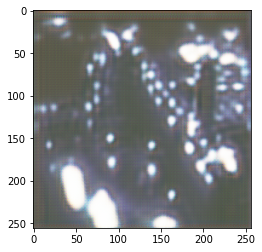

MSE - 0.05872519677544294, SIM - 0.5417308927876613
Original Day Image


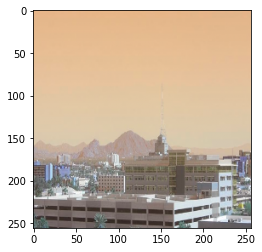

Generated Day Image


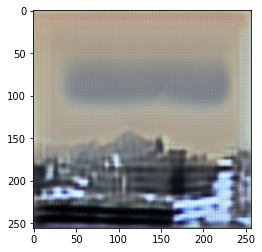

MSE - 0.033070979090132464, SIM - 0.7432601195510964
Original Night Image


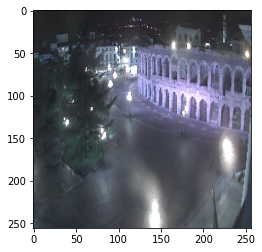

Generated Night Image


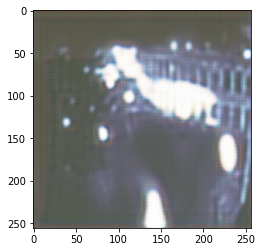

MSE - 0.02231610129621728, SIM - 0.7014767160429008
Original Day Image


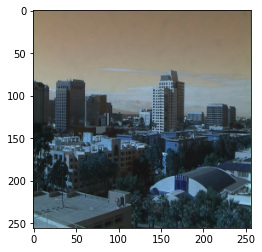

Generated Day Image


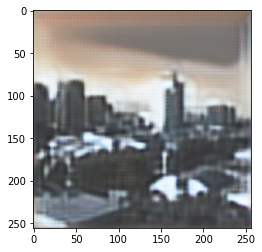

MSE - 0.031606798230507716, SIM - 0.6852939351869874
Original Night Image


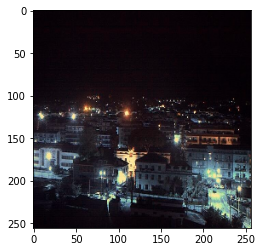

Generated Night Image


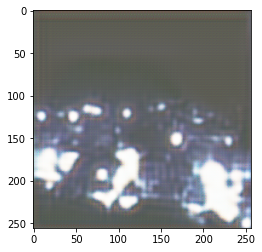

MSE - 0.12047334573483227, SIM - 0.253000064819509
Original Day Image


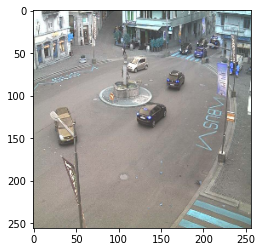

Generated Day Image


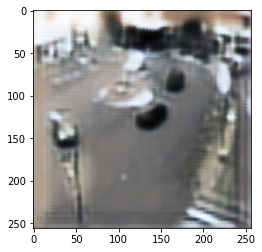

MSE - 0.028519844940485817, SIM - 0.6319229014338705
Original Night Image


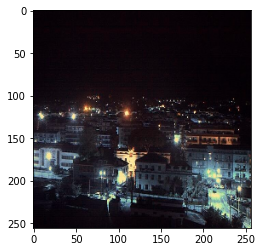

Generated Night Image


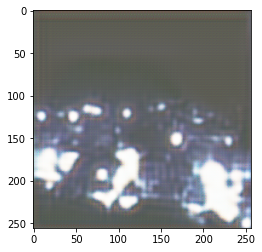

MSE - 0.12047334302141992, SIM - 0.25300006784892776
Original Day Image


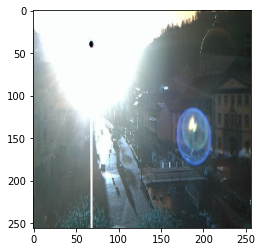

Generated Day Image


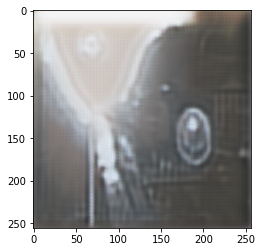

MSE - 0.012786307990818197, SIM - 0.830334042368113
Original Night Image


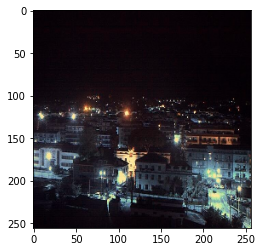

Generated Night Image


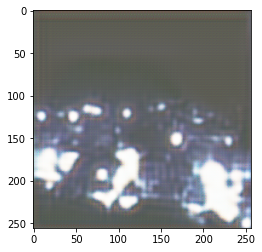

MSE - 0.12047334363272182, SIM - 0.253000068505049
Original Day Image


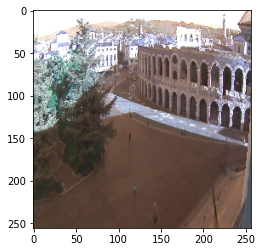

Generated Day Image


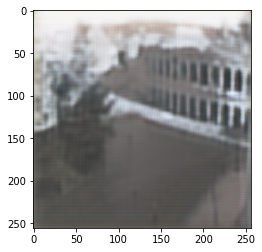

MSE - 0.013131931321026392, SIM - 0.6770071465277109
Original Night Image


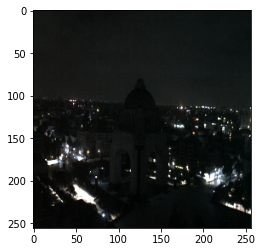

Generated Night Image


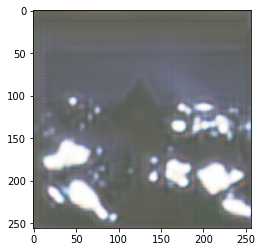

MSE - 0.15616546723932875, SIM - 0.26419334335227457
Original Day Image


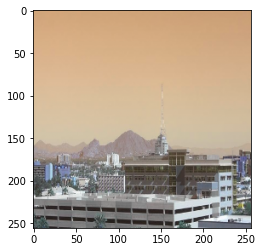

Generated Day Image


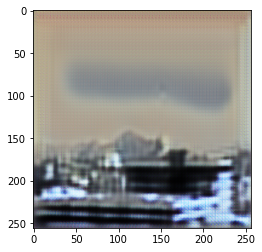

MSE - 0.023641178173191005, SIM - 0.734670803638028
Original Night Image


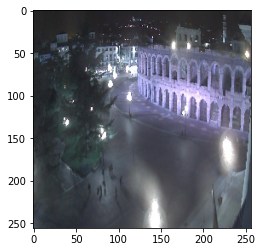

Generated Night Image


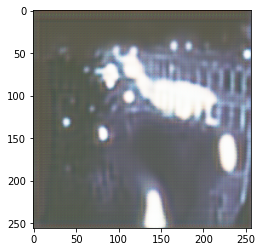

MSE - 0.022256646894328838, SIM - 0.6972659520025246
Original Day Image


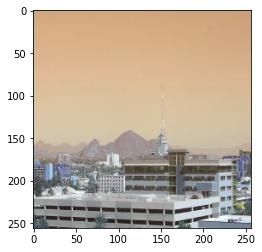

Generated Day Image


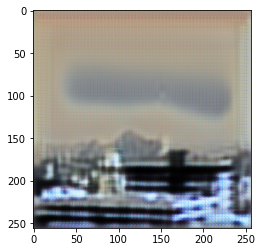

MSE - 0.02893959921897243, SIM - 0.7291063574975002
Original Night Image


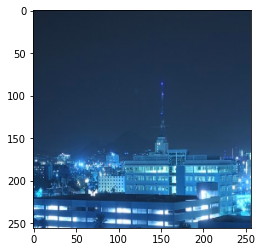

Generated Night Image


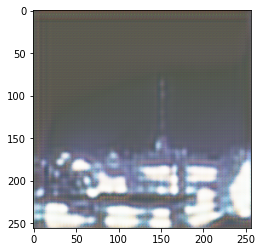

MSE - 0.04917525709031701, SIM - 0.6622050762142175
Original Day Image


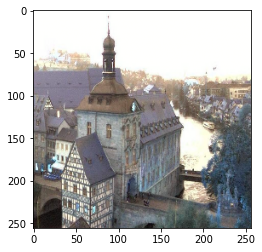

Generated Day Image


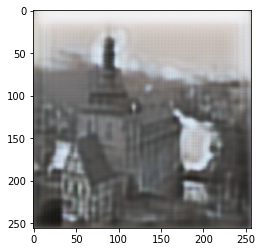

MSE - 0.025831704878721815, SIM - 0.6667622149844684
Original Night Image


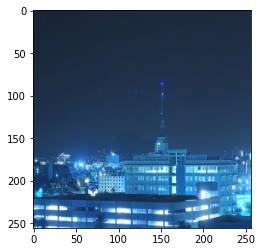

Generated Night Image


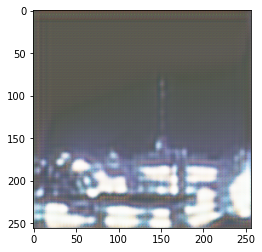

MSE - 0.047577721118734116, SIM - 0.6654663182805388
Original Day Image


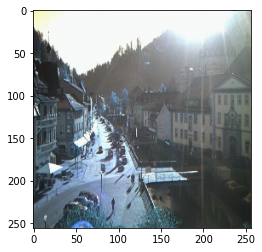

Generated Day Image


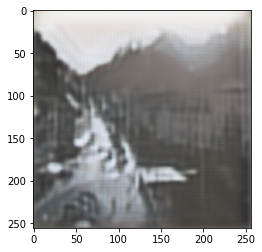

MSE - 0.009707302755170363, SIM - 0.738516576597195
Original Night Image


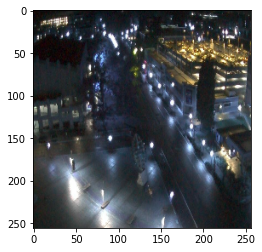

Generated Night Image


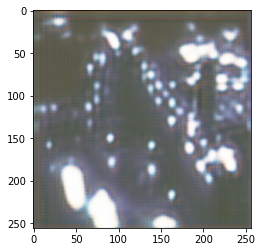

MSE - 0.05889311591505635, SIM - 0.5388453891664448
Original Day Image


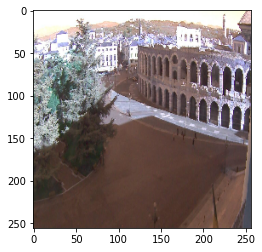

Generated Day Image


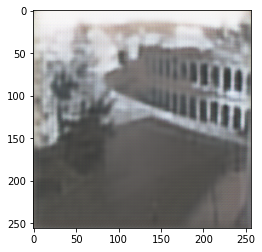

MSE - 0.013966219475676623, SIM - 0.6599248764951962
Original Night Image


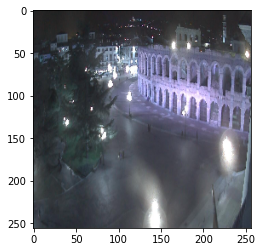

Generated Night Image


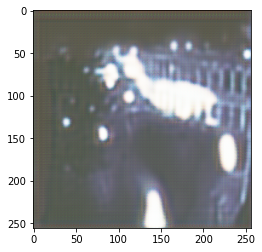

MSE - 0.022133094447584944, SIM - 0.7002311405495281
Original Day Image


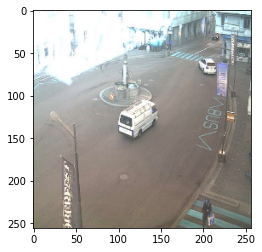

Generated Day Image


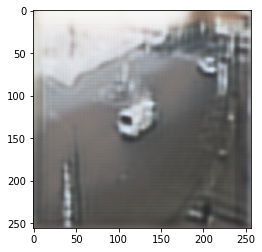

MSE - 0.020145803041826265, SIM - 0.7643396464312268
Original Night Image


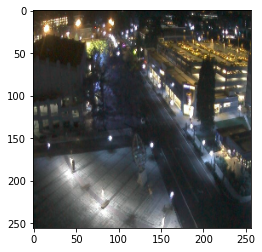

Generated Night Image


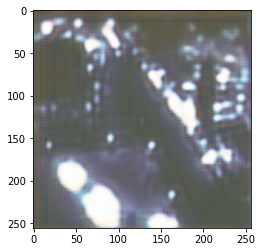

MSE - 0.04688211129525955, SIM - 0.5791142307105126
Original Day Image


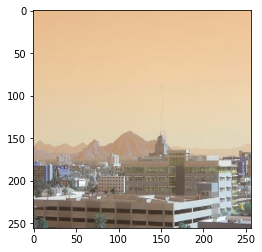

Generated Day Image


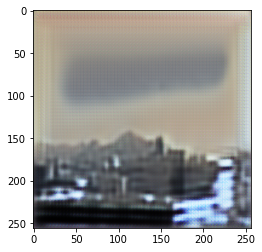

MSE - 0.04015736158091132, SIM - 0.7339529994524009
Original Night Image


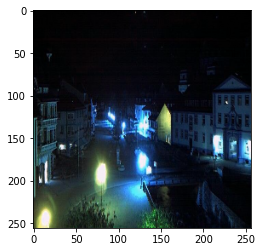

Generated Night Image


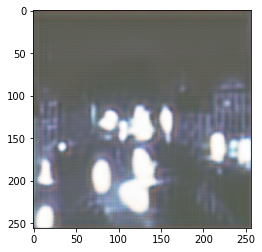

MSE - 0.11472227464167367, SIM - 0.27407590698883094
Original Day Image


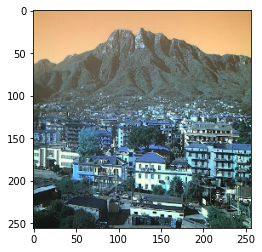

Generated Day Image


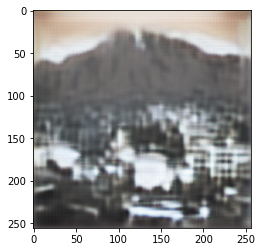

MSE - 0.028708591413047102, SIM - 0.5232794846776971
Original Night Image


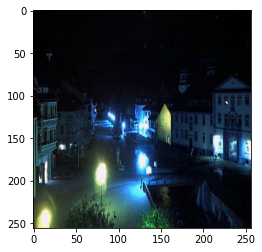

Generated Night Image


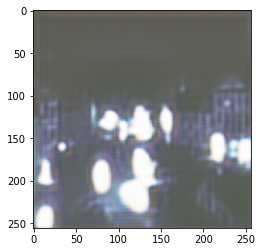

MSE - 0.1153400600728678, SIM - 0.27017665705341737
Original Day Image


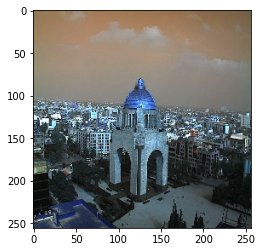

Generated Day Image


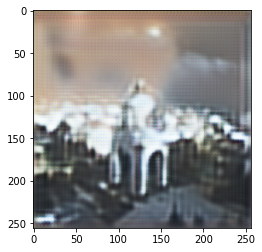

MSE - 0.03740111071273124, SIM - 0.6014337379568608
Original Night Image


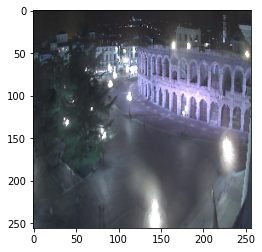

Generated Night Image


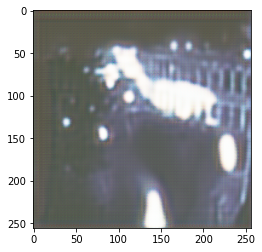

MSE - 0.021920659985995825, SIM - 0.7023056079700604
Original Day Image


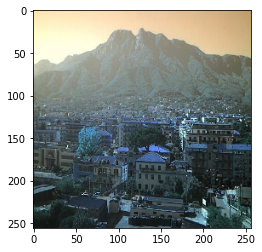

Generated Day Image


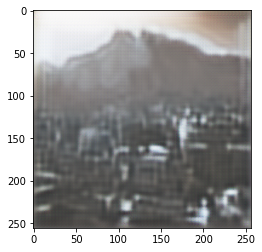

MSE - 0.016194625070292363, SIM - 0.6294886566159213
Original Night Image


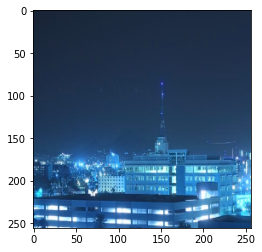

Generated Night Image


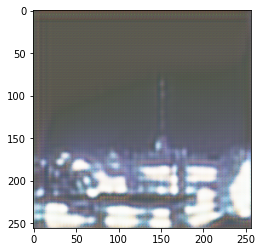

MSE - 0.04654007176626549, SIM - 0.6671236351285067
Original Day Image


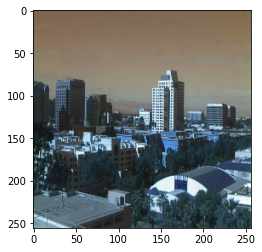

Generated Day Image


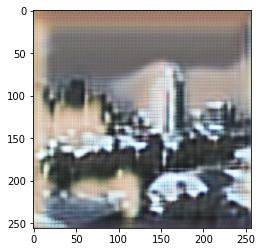

MSE - 0.055480209135470554, SIM - 0.5627096296328237
Original Night Image


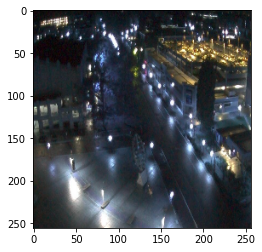

Generated Night Image


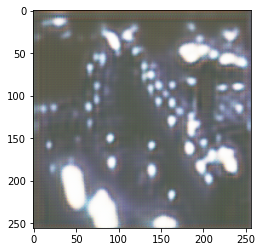

MSE - 0.06000839437644051, SIM - 0.5355808136490886
Original Day Image


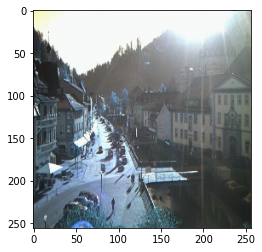

Generated Day Image


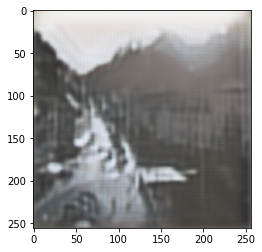

MSE - 0.009707302373455464, SIM - 0.7385165789216576
Original Night Image


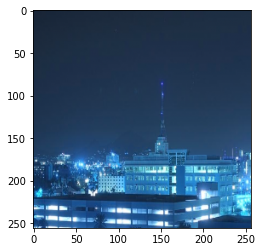

Generated Night Image


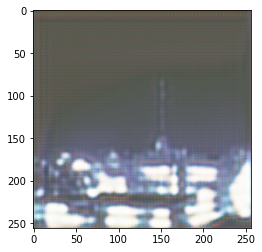

MSE - 0.04870957578947372, SIM - 0.6661794025209898
Original Day Image


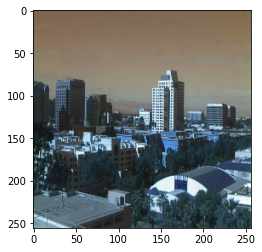

Generated Day Image


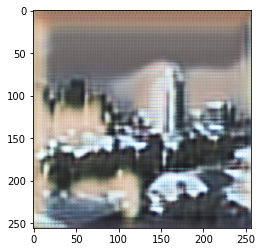

MSE - 0.055480207302226754, SIM - 0.5627096384952276
Original Night Image


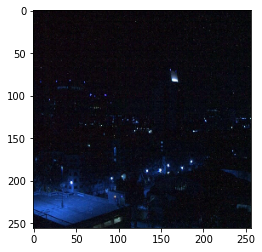

Generated Night Image


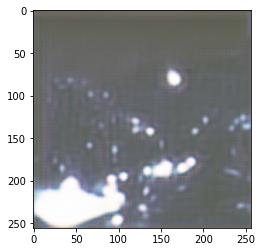

MSE - 0.16732937514944066, SIM - 0.20503614981335835
Original Day Image


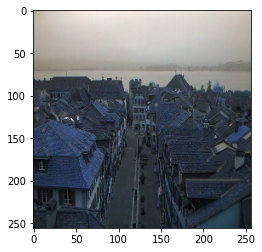

Generated Day Image


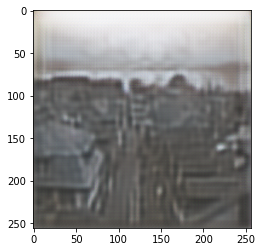

MSE - 0.019498402865425497, SIM - 0.686710842824103
Original Night Image


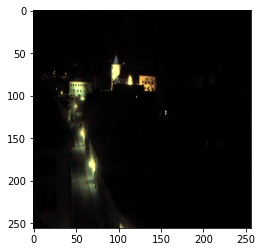

Generated Night Image


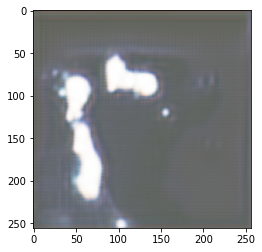

MSE - 0.1962789656243923, SIM - 0.04364509716049467
Original Day Image


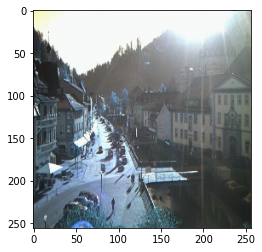

Generated Day Image


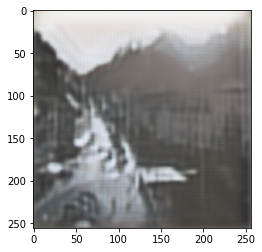

MSE - 0.009707302455299487, SIM - 0.738516578248786
Original Night Image


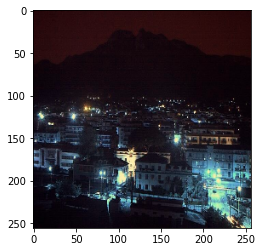

Generated Night Image


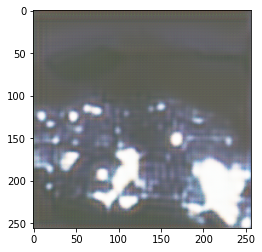

MSE - 0.1140377419465095, SIM - 0.2986006707932258
Original Day Image


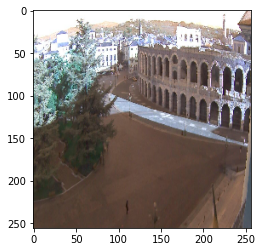

Generated Day Image


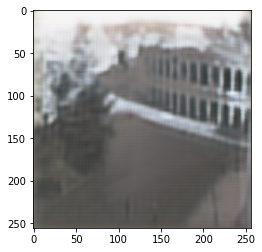

MSE - 0.012900185187653805, SIM - 0.6813848676289287
Original Night Image


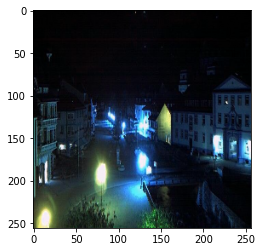

Generated Night Image


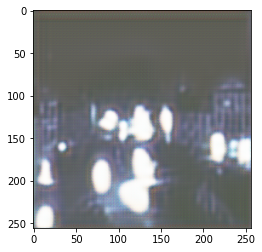

MSE - 0.11472227615116443, SIM - 0.27407590468143256
Original Day Image


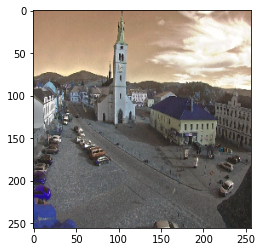

Generated Day Image


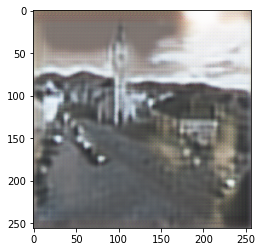

MSE - 0.013419696414958772, SIM - 0.6806348509877514
Original Night Image


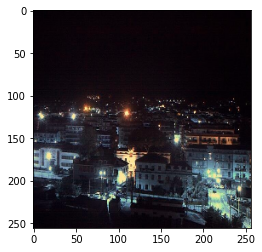

Generated Night Image


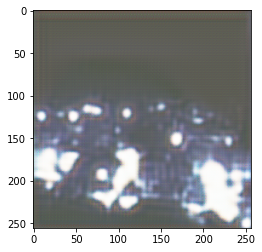

MSE - 0.12115502976851661, SIM - 0.2498085470271445
Original Day Image


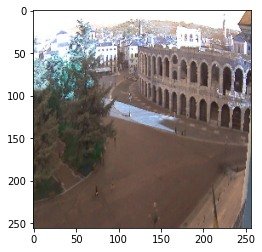

Generated Day Image


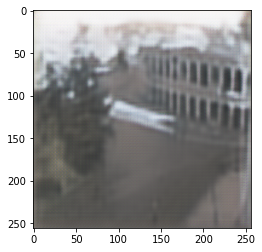

MSE - 0.011136252720605158, SIM - 0.7060483300613044
Original Night Image


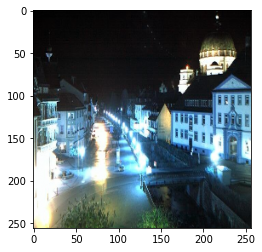

Generated Night Image


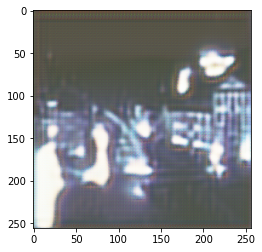

MSE - 0.04571388527453546, SIM - 0.46970233360371233
Original Day Image


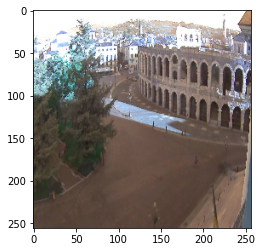

Generated Day Image


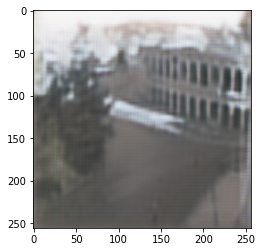

MSE - 0.011673956819554325, SIM - 0.7004178745431986
Original Night Image


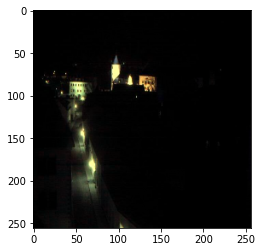

Generated Night Image


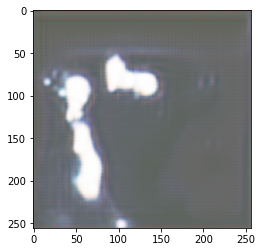

MSE - 0.1968492437839493, SIM - 0.04111199646242163
Original Day Image


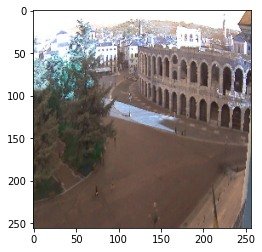

Generated Day Image


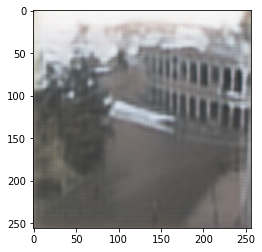

MSE - 0.011136252343054988, SIM - 0.7060483327021405
Original Night Image


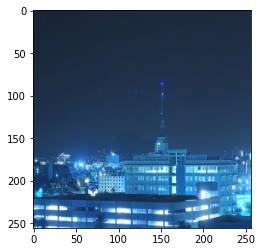

Generated Night Image


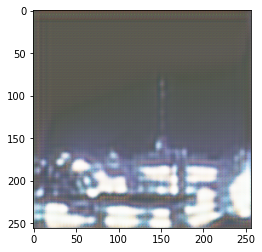

MSE - 0.04757772210683318, SIM - 0.6654663149050749
Original Day Image


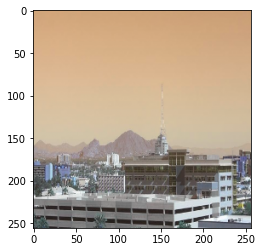

Generated Day Image


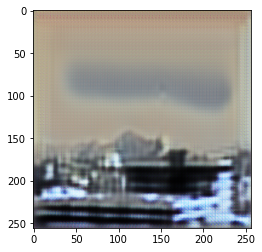

MSE - 0.023641178018242823, SIM - 0.7346708089873076
Original Night Image


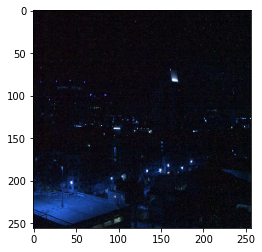

Generated Night Image


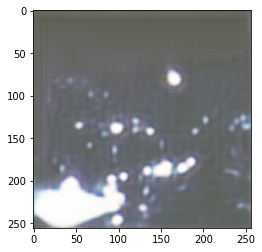

MSE - 0.1669482852835108, SIM - 0.20666061258143154
Original Day Image


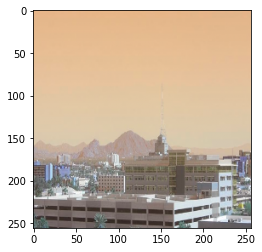

Generated Day Image


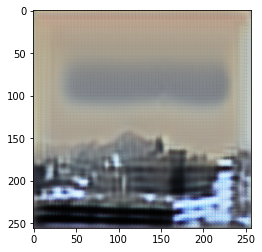

MSE - 0.03307097694215907, SIM - 0.7432601272707932
Original Night Image


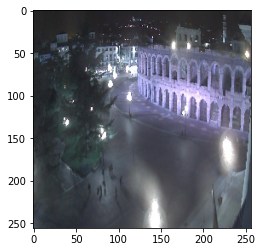

Generated Night Image


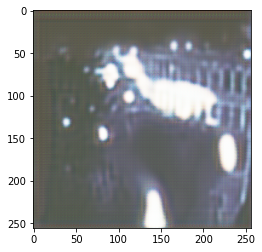

MSE - 0.0222566464760962, SIM - 0.6972659524592556


In [43]:
# Call the function test_Cycle(....)
test_Cycle(g_model_AtoB, g_model_BtoA, c_model_AtoB, c_model_BtoA, trainA, trainB)

# **Summary and Discussion:** **Discuss** "What domain transformation is better quality (day to night to day or dight to day t0 night?) and what are some ways to ensure quality transformations?
# Think in terms of Data, Process and Outcomes specifically.
## Consider the following:
1. Can you process the data in some other way? Optimal image size? Patch size?
2. Given a new data set on the job, how would you report the best "method"? (which transformation and why?)
3. What is the metric/metrics you would use to report your results?

#Share screen and discuss findings. Think about generalizability (something that works across data sets)

# Comment on which 
with images are resized to 256 and when did without normalizing to 255.0, I got bad results, after normalizing with 255.0 got some good results. Might be training on whole dataset might give more good results. I used mse and simalarity functions to measure real vs fake. 
